# Simulation of MoblGamr User Data

This Notebook will employ a very simple and crude agent based model to simulate MoblGamr (MG) user data.  We can then use this simulated data to test out the proposed stability measures in the **MoblGamr** Notebook.  **MoblGamr** is written in Python, but what follows will be written in [Julia](http://julialang.org/) because this research task is a convenient excuse to practice building a small simulation in Julia.  It seems like a nice way to showcase the syntax of an interpreted language that [features speeds close to C or Fortran](http://julialang.org/benchmarks/) (and may have the added benefit of highlighting facility with multiple languages).

The approach will be to construct a population of `Player()` objects, each of which possesses characteristics governed by one of three player types:

1. Short-Term User
2. Sporadic User
3. Heavy User

The goal of data we will simulate is to allow us to separate out different behaviors across players.  We actually do not need to generate growth over the time period considered to achieve this objective, so we will only be generating a static population (that is, same people in and out).  However, accommodation for a dynamic set (one that changes size over the time window) is certainly achievable if necessary.  It would simply require an extra layer of complexity governing entry and exit.

In [19]:
using Distributions
using Gadfly
using Color
using DataFrames

## Single Player Dynamics

Each player has the following attributes:

+ `id` is an integer tag that captures the player ID number
+ `games` is a list of integers that captures the ID numbers of the games the player plays
+ `p_add` is the probability that the player will acquire a new game
+ `p_drop` is the probability, given the existence of at least one game, the player will drop a game (and potentially exit the user base)
+ `p_play` is the probability, given the existence of at least one game, that the player will play (extensive)
+ $\delta$ is a probability distribution governing the length of play

`p_add`, `p_drop`, and `p_play` are all governed by the Bernoulli distribution, while $\delta$ is governed by the Beta distribution.  The distributional parameters are different for each player type:

Player Type|`p_add`|`p_drop`|`p_play`|$\delta$
-----------|--------|-------|--------|--------
Short-Term|`Bernoulli(0.1)`|`Bernoulli(0.8)`|`Bernoulli(0.6)`|`Beta(3,10)`
Sporadic|`Bernoulli(0.3)`|`Bernoulli(0.3)`|`Bernoulli(0.2)`|`Beta(5,5)`
Heavy|`Bernoulli(0.6)`|`Bernoulli(0.2)`|`Bernoulli(0.9)`|`Beta(10,3)`

In practice, the binary decision probabilities are much too high for each time increment if we are dealing in minutes.  Consequently, we will scale them down, while still sampling at the minute level.  In other words, each will be divided by some scalar (e.g. 1000).  One could certainly debate the appropriateness of the probabilities used, but they suffice for demonstration's sake.

The `Beta()` distributions range from 0 to 1, so draws from them will capture the proportion of maximum play time for the population.  The maximum time is set parametrically at 30 minutes.  The plot below demonstrates the shape of the probability density functions for each type of player.

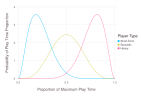

In [20]:
#Define Beta distributions by player type
pt1=Beta(3,10)
pt2=Beta(5,5)
pt3=Beta(10,3)

#Capture arrays drawn from player type distributions
pt1_arr=rand(pt1,1000)
pt2_arr=rand(pt2,1000)
pt3_arr=rand(pt3,1000)

#Capture default colors
dblue,dyellow,dred=Scale.color_discrete_hue().f(3)

#Plot Beta distributions (for length of play time)
plot([x->pdf(pt1,x),
      x->pdf(pt2,x),
      x->pdf(pt3,x)],
      0,1,
Guide.xlabel("Proportion of Maximum Play Time"),
Guide.ylabel("Probability of Play Time Proportion"),
Guide.manual_color_key("Player Type",["Short-Term","Sporadic","Heavy"],[dblue,dyellow,dred]))

Now, let's construct our `player()` object.

In [21]:
type player
    id::Int64
    games::Array{Int64}
    playing::Int64
    p_add::Float64
    p_drop::Float64
    p_play::Float64
    δ
    
    #Define inner constructor
    player(id,games,playing,p_add,p_drop,p_play,δ)=new(id,games,playing,p_add,p_drop,p_play,δ)    
end

    

For easy access we will create a dictionary (a.k.a. hash table) mapping each player type's attributes to numeric values.  Note that the `player.id` is initialized to 1.  We can change it if need be.

In [22]:
#Define weekly scale factor
# ws=10080
ws=1000

#Define mapping from ptype to associated player object
player_options=[player(1,Int64[rand(1:30)],0,.1/ws,.8/ws,.6/ws,Beta(3,10)),
                player(1,Int64[rand(1:30)],0,.3/ws,.3/ws,.2/ws,Beta(5,5)),
                player(1,Int64[rand(1:30)],0,.6/ws,.2/ws,.9/ws,Beta(10,3))]
player_dict=Dict(zip([1,2,3],player_options))

Dict{Int64,player} with 3 entries:
  2 => player(1,[15],0,2.9761904761904762e-5,2.9761904761904762e-5,1.9841269841…
  3 => player(1,[25],0,5.9523809523809524e-5,1.984126984126984e-5,8.92857142857…
  1 => player(1,[18],0,9.92063492063492e-6,7.936507936507937e-5,5.9523809523809…

We need to define functions that govern the game list and playing time.

In [23]:
function add_game(player)
    #Draw from Bernoulli
    b_r=rand(Bernoulli(player.p_add))
    #Add game if == 1
    if b_r==1
        push!(player.games,rand(1:30))
    else
    end
end

function drop_game(player)
    #Draw from Bernoulli
    b_r=rand(Bernoulli(player.p_drop))
    #Drop game if == 1 and at least one game exists
    if b_r==1 && length(player.games)>0
        deleteat!(player.games,rand(1:length(player.games)))
    else
    end
end

function start_play(player)
    #Draw from Bernoulli
    b_r=rand(Bernoulli(player.p_play))
    #Play game if == 1, at least one game exists, and player is not already playing
    if b_r==1 && length(player.games)>0 && player.playing==0
        player.playing=1
    else
        player.playing=0
    end
end

function play_prop(player)
    #Note that we only want new draws when the player *is not* playing
    #Duration should be constant once play is initiated
    if player.playing==0
        return rand(player.δ)
    else
    end
end

play_prop (generic function with 1 method)

The approach taken here is to process players through the entire time window, one at a time.  In each time increment, players have the opportunity to add games, drop games, or start playing.  Of course, if they are already playing, they can't start, but they can stop.  To capture all of these decisions, a new function housing all of the choices for each time increment is needed.

In [24]:
#Initialize test player
test=player(1,Int64[rand(1:30)],0,.1,.8,.6,Beta(3,10))

function making_moves(player,max_time::Int64,curr_time::Int64,game_start_time::Int64,ptime::Float64,game_on_deck::Int64)
    pid=player.id
    println("\n\nID: $pid")
    println("Time: $curr_time")
    #Only make changes to game stock while idle
    if player.playing==0
        #Add game?
        add_game(player)
        g=player.games
        println("Games: $g")
        #Drop game?
        drop_game(player)
        g=player.games
        println("Games: $g")
    end
    stat=player.playing
    println("Status: $stat")
    #If they are not playing and a game is available...
    if player.playing==0 && length(player.games)>0
        #...select a potential game...
        game_idx=rand(1:length(player.games))
        game_on_deck=player.games[game_idx]
        println("Possible Game: $game_on_deck")
        #...select a potential playing time...
        ptime=play_prop(player)*max_time
        println("Possible Play Time: $ptime")
        #...and decide whether or not to play
        start_play(player)
        stat=player.playing
        println("New Status: $stat")
    elseif player.playing==1 && (curr_time-game_start_time ≥ ptime)
        println("Already Playing!  Start: $game_start_time")
        #If they are already playing and have finished the session, stop playing
        player.playing=0
    elseif player.playing==1
        #If they are mid-session, just a do a little reporting
        println("Already Playing!  Start: $game_start_time")
        println("Current Game: $game_on_deck")
        println("Time Allocated to Game: $ptime")
    else
    end
    
    return(player.id,curr_time,game_start_time,ptime,game_on_deck,player.playing)
end

making_moves(test,60,100,80,25.,test.games[1])

        
        



ID: 1
Time: 100
Games: [2]
Games: []
Status: 0


(1,100,80,25.0,2,0)

The next step is run our players through the full complement of time periods.  At each stage, their choices on game stock and game play are conditioned on the playing state (pursuant to the `making_moves()` method).  The function that navigates the full time period must document and return information about which games are being played, and the duration of play.

In [25]:
test=player(1,Int64[rand(1:30)],0,.1,.8,.6,Beta(3,10))

function player_usage_series(player,nperiods,max_play_time)
    #Set max play time
    max_time=max_play_time

    #Initialize first play time
    ptime=play_prop(player)*max_time

    #Initialize first game on deck
    println(player.games)
    game_on_deck=player.games[1]

    #Create lists to hold usage data
    id=Int64[]
    time=Int64[]
    st=Int64[]
    pt=Float64[]
    game=Int64[]
    playing=Int64[]

    #For each time increment...
    for t_i in 1:nperiods
        #...if the player is not currently playing... 
        if player.playing==0
            #...update the game start
            game_start_time=t_i
        end
        #Execute choices
        choices=making_moves(player,max_time,t_i,game_start_time,ptime,game_on_deck)
        #Capture consequences and associated info
        push!(id,choices[1])
        push!(time,choices[2])
        push!(st,choices[3])
        push!(pt,choices[4])
        push!(game,choices[5])
        push!(playing,choices[6])
        #Update playing time
        ptime=choices[4]
        #Update game on deck
        game_on_deck=choices[5]
    end
    return(DataFrame(id=id,time=time,start=st,ptime=pt,game=game,status=playing))
end

test_series=player_usage_series(test,100,30)

[25]


ID: 1
Time: 1
Games: [25]
Games: [25]
Status: 0
Possible Game: 25
Possible Play Time: 14.424333144496432
New Status: 1


ID: 1
Time: 2
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocated to Game: 14.424333144496432


ID: 1
Time: 3
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocated to Game: 14.424333144496432


ID: 1
Time: 4
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocated to Game: 14.424333144496432


ID: 1
Time: 5
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocated to Game: 14.424333144496432


ID: 1
Time: 6
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocated to Game: 14.424333144496432


ID: 1
Time: 7
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocated to Game: 14.424333144496432


ID: 1
Time: 8
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocated to Game: 14.424333144496432


ID: 1
Time: 9
Status: 1
Already Playing!  Start: 1
Current Game: 25
Time Allocate

,id,time,start,ptime,game,status
1,1,1,1,14.424333144496432,25,1
2,1,2,1,14.424333144496432,25,1
3,1,3,1,14.424333144496432,25,1
4,1,4,1,14.424333144496432,25,1
5,1,5,1,14.424333144496432,25,1
6,1,6,1,14.424333144496432,25,1
7,1,7,1,14.424333144496432,25,1
8,1,8,1,14.424333144496432,25,1
9,1,9,1,14.424333144496432,25,1
10,1,10,1,14.424333144496432,25,1


In [26]:
test_series

,id,time,start,ptime,game,status
1,1,1,1,14.424333144496432,25,1
2,1,2,1,14.424333144496432,25,1
3,1,3,1,14.424333144496432,25,1
4,1,4,1,14.424333144496432,25,1
5,1,5,1,14.424333144496432,25,1
6,1,6,1,14.424333144496432,25,1
7,1,7,1,14.424333144496432,25,1
8,1,8,1,14.424333144496432,25,1
9,1,9,1,14.424333144496432,25,1
10,1,10,1,14.424333144496432,25,1


## Generation of the Population

Now we need to generate an entire population of individuals that we can run through all time periods.  This actually gets to the heart of the matter for MG.  We have three types, and one could make the case that they are most interested in heavy users.  Given our simulation, we have the capacity to explicitly define the composition of player types in the population, which is useful for evaluating proposed measures.  For the time being, we will just stick with a uniform prior across player types, though one could certainly generalize to more complicated distributions. 

To accommodate the more general case, we will employ the approach commonly used for random number generation for inspiration.  Uniform draws from the inverse CDF of a given distribution, $\omega$, returns random draws from $\omega$.  Definition of the CDF can be achieved via ex ante knowledge of the draw probability for each value in the distribution's support.  In our case, there are only three such values (player types 1 through 3) and we are actively deciding which probabilities we want to attach.  Consequently, we can define a random player chooser sub-function to assist our main population generation function.  This sub-function is scaleable to an arbitrary number of types.

First, the sub-function...

In [27]:
function which_player(pvec)
    #Define size of population from which types are drawn
    n=1000
    #Define counts for each player type
    n_p=[convert(Int64,floor(p*n)) for p in pvec]
    #Capture total population
    #(The dots are weird, but Julia returns an array of arrays without them
    #instead of a single multi-dim array which can then be reshaped)
    pop=reshape(hcat([fill(i,val) for (i,val) in enumerate(n_p)]...),1,sum(n_p))
    #Generate random permutation of pop
    perm_idx=randperm(length(pop))
    pop=pop[perm_idx]
    
    return(pop[rand(1:length(pop))])
end

# ct1,ct2,ct3=(0,0,0)
# for i in 1:10000
#     x=which_player([1/3 for i in 1:3])
#     if x==1
#         ct1+=1
#     elseif x==2
#         ct2+=1
#     else
#         ct3+=1
#     end
# end

# ct1,ct2,ct3

which_player (generic function with 1 method)

...and now the population generation function.

In [28]:
function pop_gen(p_dict,nplayers)
    #Create container to hold player types
    ptype_list=Int64[]
    #Create container to hold players
    #(note that it must be initialized to handle player objects)
    plist=player[]
    for i in 1:nplayers
        #Decide which player type we are generating
        ptype=which_player([1/3 for i in 1:3])
        #Generate new player of type ptype
        #(note that if a copy is not made, the underlying dict is changed)
        new_player=deepcopy(player_dict[ptype])
        #Assign a player ID
        new_player.id=i
        #Assign a random game
        new_player.games=Int64[rand(1:30)]
        #Throw player type in ptype_list
        push!(ptype_list,ptype)
        #Throw the player into plist
        push!(plist,new_player)
    end
    return(ptype_list,plist)
end
    
pop_gen(player_dict,5)    

([2,1,2,2,1],[player(1,[6],0,2.9761904761904762e-5,2.9761904761904762e-5,1.984126984126984e-5,Beta(α=5.0, β=5.0)),player(2,[24],0,9.92063492063492e-6,7.936507936507937e-5,5.9523809523809524e-5,Beta(α=3.0, β=10.0)),player(3,[10],0,2.9761904761904762e-5,2.9761904761904762e-5,1.984126984126984e-5,Beta(α=5.0, β=5.0)),player(4,[19],0,2.9761904761904762e-5,2.9761904761904762e-5,1.984126984126984e-5,Beta(α=5.0, β=5.0)),player(5,[26],0,9.92063492063492e-6,7.936507936507937e-5,5.9523809523809524e-5,Beta(α=3.0, β=10.0))])

Generating the entire population is now a straightforward exercise.

In [29]:
#Define size of player population
player_pop_size=1000

#Generate player population
ptype_pop,player_pop=pop_gen(player_dict,player_pop_size)

([1,2,1,2,3,3,3,2,3,1  …  3,2,2,1,2,1,3,2,3,3],[player(1,[23],0,9.92063492063492e-6,7.936507936507937e-5,5.9523809523809524e-5,Beta(α=3.0, β=10.0)),player(2,[3],0,2.9761904761904762e-5,2.9761904761904762e-5,1.984126984126984e-5,Beta(α=5.0, β=5.0)),player(3,[13],0,9.92063492063492e-6,7.936507936507937e-5,5.9523809523809524e-5,Beta(α=3.0, β=10.0)),player(4,[16],0,2.9761904761904762e-5,2.9761904761904762e-5,1.984126984126984e-5,Beta(α=5.0, β=5.0)),player(5,[5],0,5.9523809523809524e-5,1.984126984126984e-5,8.928571428571429e-5,Beta(α=10.0, β=3.0)),player(6,[8],0,5.9523809523809524e-5,1.984126984126984e-5,8.928571428571429e-5,Beta(α=10.0, β=3.0)),player(7,[10],0,5.9523809523809524e-5,1.984126984126984e-5,8.928571428571429e-5,Beta(α=10.0, β=3.0)),player(8,[15],0,2.9761904761904762e-5,2.9761904761904762e-5,1.984126984126984e-5,Beta(α=5.0, β=5.0)),player(9,[10],0,5.9523809523809524e-5,1.984126984126984e-5,8.928571428571429e-5,Beta(α=10.0, β=3.0)),player(10,[21],0,9.92063492063492e-6,7.936507936

It would be useful to know the type of each player, so let's store that information in a DataFrame and write it to disk.

In [30]:
ptype_df=DataFrame(id=1:player_pop_size,
                   ptype=ptype_pop)

writetable("/home/choct155/projects/moblgamr_ptypes.csv",ptype_df)

## Generation of Simulated Data Set

Finally, we can run our population through the time period of the simulation window.  To reiterate, the approach will be the following:

+ Loop through each member of the population;
+ Generate a usage series for said member;
+ Collect the DataFrames capturing these series; and,
+ Concatenate them together.

Once we have this set, we can write it to disk and test out our stability indicators. A minor obstacle here is that the [DataFrames package for Julia](https://dataframesjl.readthedocs.org/en/latest/introduction.html) is nowhere near as developed as the [pandas package for Python](http://pandas.pydata.org/).  One consequence is that there doesn't seem to be an equivalent Julia method for `pandas.concat()` (which makes concatenating a list of DataFrames a single line operation).  The work around will involve the definition of a function to concatenate [DataArray](https://dataframesjl.readthedocs.org/en/latest/introduction.html#dataarray-efficient-arrays-with-missing-values) objects.  Each concatenated DataArray column will then need to be manually fed into a [DataFrame](https://dataframesjl.readthedocs.org/en/latest/introduction.html#dataframe-tabular-data-sets) object.  

In [31]:
function darray_concat(da)
    #Create output array
    out_array=DataArray[]
    #For each column...
    for j in 1:size(da[1])[1]
#         println("\n\nj=$j")
        #...create a temp container to hold concatenated column values...
        tmp_col=DataArray[]
        #...and for each player-specific component of that column...
        for i in 1:size(da)[1]
#             println("i=$i")
            #...add the component values to tmp_col
            push!(tmp_col,da[i][j])
        end
        #...vertically concatenate the entire column and add it it to out_array
        push!(out_array,vcat(tmp_col...))
    end
    return(out_array)
end



darray_concat (generic function with 1 method)

With that function in hand, let's grab our list of DataArrays from each player.

In [ ]:
#Create a deep copy of the population
ppop=deepcopy(player_pop)

#Create container for player-specific DataArrays
da_list=Array[]

#For each player...
for p in ppop
    println(p)
    #...capture their usage...
    tmp_usage=player_usage_series(p,10000,30)
    #...and throw it in da_list
    push!(da_list,values(tmp_usage))
end

#Generate a consolidated array
da_out=darray_concat(da_list)

#Create output DataFrame
df_out=DataFrame(id=da_out[1],
                 time=da_out[2],
                 start=da_out[3],
                 ptime=da_out[4],
                 game=da_out[5],
                 status=da_out[6])

player(1,[23],0,9.92063492063492e-6,7.936507936507937e-5,5.9523809523809524e-5,Beta(α=3.0, β=10.0))
[23]


ID: 1
Time: 1
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 7.522222698581404
New Status: 0


ID: 1
Time: 2
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 6.185692817031868
New Status: 0


ID: 1
Time: 3
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 5.825812342175227
New Status: 0


ID: 1
Time: 4
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 3.2706521900413907
New Status: 0


ID: 1
Time: 5
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 10.493466889604791
New Status: 0


ID: 1
Time: 6
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 13.251718162109627
New Status: 0


ID: 1
Time: 7
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 6.795824728592147
New Status: 0


ID: 1
Time: 8
Games: [23]
Games: [23]
Status: 0
Po

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 12.563138341943713
New Status: 0


ID: 1
Time: 9543
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 1.3525707496221342
New Status: 0


ID: 1
Time: 9544
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 4.043715026926258
New Status: 0


ID: 1
Time: 9545
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 13.73422254841512
New Status: 0


ID: 1
Time: 9546
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 6.0592814239614725
New Status: 0


ID: 1
Time: 9547
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 8.882570677894845
New Status: 0


ID: 1
Time: 9548
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 9.245658607210238
New Status: 0


ID: 1
Time: 9549
Games: [23]
Games: [23]
Status: 0
Possible Game: 23
Possible Play Time: 6.051205049231203
New Status: 0


ID: 1
Time: 9550
Games: [23]
Games: [23]


 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Time: 8691
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 21
Possible Play Time: 6.219117157716548
New Status: 0


ID: 2
Time: 8692
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 3
Possible Play Time: 17.21030665538355
New Status: 0


ID: 2
Time: 8693
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 21
Possible Play Time: 19.054130902960104
New Status: 0


ID: 2
Time: 8694
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 21
Possible Play Time: 11.423398887549682
New Status: 0


ID: 2
Time: 8695
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 21
Possible Play Time: 20.30533072675331
New Status: 0


ID: 2
Time: 8696
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 3
Possible Play Time: 8.03912420113506
New Status: 0


ID: 2
Time: 8697
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 21
Possible Play Time: 12.600759531757575
New Status: 0


ID: 2
Time: 8698
Games: [3,21]
Games: [3,21]
Status: 0
Possible Game: 21
Possible Play Time: 18.389348088671415
New 

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Games: []
Status: 0


ID: 3
Time: 9283
Games: []
Games: []
Status: 0


ID: 3
Time: 9284
Games: []
Games: []
Status: 0


ID: 3
Time: 9285
Games: []
Games: []
Status: 0


ID: 3
Time: 9286
Games: []
Games: []
Status: 0


ID: 3
Time: 9287
Games: []
Games: []
Status: 0


ID: 3
Time: 9288
Games: []
Games: []
Status: 0


ID: 3
Time: 9289
Games: []
Games: []
Status: 0


ID: 3
Time: 9290
Games: []
Games: []
Status: 0


ID: 3
Time: 9291
Games: []
Games: []
Status: 0


ID: 3
Time: 9292
Games: []
Games: []
Status: 0


ID: 3
Time: 9293
Games: []
Games: []
Status: 0


ID: 3
Time: 9294
Games: []
Games: []
Status: 0


ID: 3
Time: 9295
Games: []
Games: []
Status: 0


ID: 3
Time: 9296
Games: []
Games: []
Status: 0


ID: 3
Time: 9297
Games: []
Games: []
Status: 0


ID: 3
Time: 9298
Games: []
Games: []
Status: 0


ID: 3
Time: 9299
Games: []
Games: []
Status: 0


ID: 3
Time: 9300
Games: []
Games: []
Status: 0


ID: 3
Time: 9301
Games: []
Games: []
Status: 0


ID: 3
Time: 9302
Games: []
Games: []
Status: 0

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Possible Play Time: 11.942655180161061
New Status: 0


ID: 4
Time: 8166
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Play Time: 23.22453137154743
New Status: 0


ID: 4
Time: 8167
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Play Time: 15.554713454577426
New Status: 0


ID: 4
Time: 8168
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Play Time: 16.6202612767073
New Status: 0


ID: 4
Time: 8169
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Play Time: 14.170214892797457
New Status: 0


ID: 4
Time: 8170
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Play Time: 15.848951074047454
New Status: 0


ID: 4
Time: 8171
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Play Time: 16.356349422398672
New Status: 0


ID: 4
Time: 8172
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Play Time: 9.865715688003752
New Status: 0


ID: 4
Time: 8173
Games: [16]
Games: [16]
Status: 0
Possible Game: 16
Possible Pl

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Status: 0
Possible Game: 6
Possible Play Time: 23.202675955428113
New Status: 0


ID: 5
Time: 8576
Games: [5,6]
Games: [5,6]
Status: 0
Possible Game: 5
Possible Play Time: 26.260485179704038
New Status: 0


ID: 5
Time: 8577
Games: [5,6]
Games: [5,6]
Status: 0
Possible Game: 5
Possible Play Time: 26.293633164642465
New Status: 0


ID: 5
Time: 8578
Games: [5,6]
Games: [5,6]
Status: 0
Possible Game: 5
Possible Play Time: 26.961994152943134
New Status: 0


ID: 5
Time: 8579
Games: [5,6]
Games: [5,6]
Status: 0
Possible Game: 6
Possible Play Time: 24.609835080583462
New Status: 0


ID: 5
Time: 8580
Games: [5,6]
Games: [5,6]
Status: 0
Possible Game: 5
Possible Play Time: 22.190522116683493
New Status: 0


ID: 5
Time: 8581
Games: [5,6]
Games: [5,6]
Status: 0
Possible Game: 6
Possible Play Time: 24.40530757442125
New Status: 0


ID: 5
Time: 8582
Games: [5,6]
Games: [5,6]
Status: 0
Possible Game: 5
Possible Play Time: 22.249449610953956
New Status: 0


ID: 5
Time: 8583
Games: [5,6]
Games: [5,6]


 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340


Status: 0
Possible Game: 8
Possible Play Time: 21.17713155197414
New Status: 0


ID: 6
Time: 8665
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible Play Time: 17.301761098256307
New Status: 0


ID: 6
Time: 8666
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible Play Time: 27.81939538305119
New Status: 0


ID: 6
Time: 8667
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible Play Time: 20.18057663673372
New Status: 0


ID: 6
Time: 8668
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible Play Time: 26.91097790992486
New Status: 0


ID: 6
Time: 8669
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible Play Time: 19.373615685028867
New Status: 0


ID: 6
Time: 8670
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible Play Time: 19.693528838938064
New Status: 0


ID: 6
Time: 8671
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible Play Time: 22.06817680283524
New Status: 0


ID: 6
Time: 8672
Games: [8]
Games: [8]
Status: 0
Possible Game: 8
Possible P

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Possible Game: 10
Possible Play Time: 25.413736120564668
New Status: 0


ID: 7
Time: 8843
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 24.794447298881302
New Status: 0


ID: 7
Time: 8844
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 23.66289069767983
New Status: 0


ID: 7
Time: 8845
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 25.76696554792933
New Status: 0


ID: 7
Time: 8846
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 28.111367293316825
New Status: 0


ID: 7
Time: 8847
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 28.19216814498615
New Status: 0


ID: 7
Time: 8848
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 20.681382692994372
New Status: 0


ID: 7
Time: 8849
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 20.032301408524173
New Status: 0


ID: 7
Time: 8850
Games: [10]
Games: [10]
Status: 0
Possible G

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Status: 0


ID: 8
Time: 7963
Games: []
Games: []
Status: 0


ID: 8
Time: 7964
Games: []
Games: []
Status: 0


ID: 8
Time: 7965
Games: []
Games: []
Status: 0


ID: 8
Time: 7966
Games: []
Games: []
Status: 0


ID: 8
Time: 7967
Games: []
Games: []
Status: 0


ID: 8
Time: 7968
Games: []
Games: []
Status: 0


ID: 8
Time: 7969
Games: []
Games: []
Status: 0


ID: 8
Time: 7970
Games: []
Games: []
Status: 0


ID: 8
Time: 7971
Games: []
Games: []
Status: 0


ID: 8
Time: 7972
Games: []
Games: []
Status: 0


ID: 8
Time: 7973
Games: []
Games: []
Status: 0


ID: 8
Time: 7974
Games: []
Games: []
Status: 0


ID: 8
Time: 7975
Games: []
Games: []
Status: 0


ID: 8
Time: 7976
Games: []
Games: []
Status: 0


ID: 8
Time: 7977
Games: []
Games: []
Status: 0


ID: 8
Time: 7978
Games: []
Games: []
Status: 0


ID: 8
Time: 7979
Games: []
Games: []
Status: 0


ID: 8
Time: 7980
Games: []
Games: []
Status: 0


ID: 8
Time: 7981
Games: []
Games: []
Status: 0


ID: 8
Time: 7982
Games: []
Games: []
Status: 0


ID: 8
T

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Status: 0
Possible Game: 10
Possible Play Time: 24.66915945649456
New Status: 0


ID: 9
Time: 9049
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 26.10527670683488
New Status: 0


ID: 9
Time: 9050
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 24.83292828493629
New Status: 0


ID: 9
Time: 9051
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 25.704530824747422
New Status: 0


ID: 9
Time: 9052
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 18.20335181479808
New Status: 0


ID: 9
Time: 9053
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 24.16009281138875
New Status: 0


ID: 9
Time: 9054
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 24.766101604450025
New Status: 0


ID: 9
Time: 9055
Games: [10]
Games: [10]
Status: 0
Possible Game: 10
Possible Play Time: 19.73894975954966
New Status: 0


ID: 9
Time: 9056
Games: [10]
Games: [10]
Status: 0
Pos

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



New Status: 0


ID: 10
Time: 7809
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 10.262540421330776
New Status: 0


ID: 10
Time: 7810
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 10.345747412865096
New Status: 0


ID: 10
Time: 7811
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 4.897015484374058
New Status: 0


ID: 10
Time: 7812
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 4.49304842544952
New Status: 0


ID: 10
Time: 7813
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 3.5345830961441767
New Status: 0


ID: 10
Time: 7814
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 6.392790590910951
New Status: 0


ID: 10
Time: 7815
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 9.091362645410683
New Status: 0


ID: 10
Time: 7816
Games: [21]
Games: [21]
Status: 0
Possible Game: 21
Possible Play Time: 2.1619179796266668
New 

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 18.86513494717283
New Status: 0


ID: 11
Time: 8043
Games: [4]
Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 14.956219575831296
New Status: 0


ID: 11
Time: 8044
Games: [4]
Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 13.17859647589368
New Status: 0


ID: 11
Time: 8045
Games: [4]
Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 12.81487278892341
New Status: 0


ID: 11
Time: 8046
Games: [4]
Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 11.251137017614436
New Status: 0


ID: 11
Time: 8047
Games: [4]
Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 19.12039322041635
New Status: 0


ID: 11
Time: 8048
Games: [4]
Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 14.260663969166174
New Status: 0


ID: 11
Time: 8049
Games: [4]
Games: [4]
Status: 0
Possible Game: 4
Possible Play Time: 16.558889249271424
New Status: 0


ID: 11
Time: 8050
Games: [4]
Games: [4]
Status: 0
Possib

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 10.59116199584673
New Status: 0


ID: 12
Time: 8291
Games: [30]
Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 9.230519636347408
New Status: 0


ID: 12
Time: 8292
Games: [30]
Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 5.486010728050561
New Status: 0


ID: 12
Time: 8293
Games: [30]
Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 10.324107148323039
New Status: 0


ID: 12
Time: 8294
Games: [30]
Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 7.775030821653772
New Status: 0


ID: 12
Time: 8295
Games: [30]
Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 9.471214720019171
New Status: 0


ID: 12
Time: 8296
Games: [30]
Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 7.570742658455441
New Status: 0


ID: 12
Time: 8297
Games: [30]
Games: [30]
Status: 0
Possible Game: 30
Possible Play Time: 4.778799179940339
New Status: 0


ID: 12
Time: 8298
Games: [30]
Games:

 in anonymous at no file:13
 in include_string at loading.jl:97
 in execute_request_0x535c5df2 at /home/choct155/.julia/v0.3/IJulia/src/execute_request.jl:157
 in eventloop at /home/choct155/.julia/v0.3/IJulia/src/IJulia.jl:123
 in anonymous at task.jl:340



Possible Play Time: 15.186338973554083
New Status: 0


ID: 13
Time: 8757
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 19.66423229262922
New Status: 0


ID: 13
Time: 8758
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 17.822810659001764
New Status: 0


ID: 13
Time: 8759
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 22.182721461521222
New Status: 0


ID: 13
Time: 8760
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 21.117913888888967
New Status: 0


ID: 13
Time: 8761
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 17.104033033556007
New Status: 0


ID: 13
Time: 8762
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 17.150036803564078
New Status: 0


ID: 13
Time: 8763
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 8.449052204506996
New Status: 0


ID: 13
Time: 8764
Games: [9]
Games: [9]
Status: 0
Possible Game: 9
Possible Play Time: 13.24

In [ ]:
df_out

In [ ]:
size(df_out)

As can be seen, with a population of 1000 players over a period of 10,000 minutes, we have a set of usage data with 10,000,000 observations.  Let's write this puppy to disk.

In [ ]:
writetable("/home/choct155/projects/moblgamr_data.csv",df_out)